## Graph Neural Networks: Merging Deep Learning with Graphs (Part I)
> ### Application to Node Classification
> - Author: Lina Faik
> - Date: April 2021 
>
> This notebook is the support that was used to write the article *Graph Neural Networks: Merging Deep Learning with Graphs (Part I)* in Medium.  
> It contains all the experiments and the results obtained when testing GNN models and comparing them to classical ML classifier.  
> For more information, you can find the article [here](https://linafaik.medium.com/).

### Table of contents
1. [About the Dataset](#section1)  
 1.1. [Global Statistics](#section11)  
 1.2. [Visualizing of the Graph](#section12)  
2. [Modeling](#section2)  
 2.1. [Building a First Model](#section21)  
 2.2. [Comparing to a Traditional Classifier](#section22)  
 2.3. [Visualizing the Embeddings](#section23)  
3. [Explainability](#section3)  

## 1. About the Dataset <a class="anchor" id="section1"></a>
- **Source**: The dataset used for experiments is Wiki-CS from the paper [*Wiki-CS: A Wikipedia-Based Benchmark for Graph Neural Networks*](https://arxiv.org/abs/2007.02901). 
- **Description**: It consists of nodes corresponding to Computer Science articles, with edges based on hyperlinks and 10 classes representing different branches of the field. 
- **Task**: Classify each nodes.

In [95]:
# Import libraries

import dataiku
import pandas as pd, numpy as np
from dataiku import pandasutils as pdu
from dataiku import insights

import time
import networkx as nx
import random
import igraph as ig

from sklearn.metrics import classification_report, roc_auc_score
from sklearn.preprocessing import StandardScaler
from sklearn.manifold import TSNE
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import StratifiedKFold

from sklearn.manifold import TSNE
from PIL import Image
import io
import os

import igraph as ig
import plotly.io as pio
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots
pio.templates.default = "plotly_white"

import torch 
from torch_geometric.datasets import WikiCS
from torch_geometric.transforms import NormalizeFeatures

%matplotlib inline

folder = dataiku.Folder("ltkCFtt0")

In [96]:
# Load dataset 

dataset = WikiCS(root=os.path.join(folder.get_path(),'wikics'), 
                       pre_transform=NormalizeFeatures())
data = dataset[0]

# Add the number of classes
data.num_classes = data.y.unique().shape[0]

### 1.1. Global Statistics <a class="anchor" id="section11"></a>

In [97]:
data

Data(x=[11701, 300], edge_index=[2, 297110], y=[11701], train_mask=[11701, 20], val_mask=[11701, 20], test_mask=[11701], stopping_mask=[11701, 20], num_classes=10)

In [98]:
# Get some basic info about the dataset
# print(f'Number of graphs: {len(dataset)}')
print(f'Number of features: {dataset.num_features}')
print(f'Number of classes: {dataset.num_classes}')
print(50*'=')  

# Gather some basic info about the graph
print(data)
print(f'Number of nodes: {data.num_nodes}')
print(f'Number of edges: {data.num_edges}')
print(50*'=')

# Gather some statistics about the graph
print(f'Average node degree: {data.num_edges / data.num_nodes:.2f}')
print(f'Has isolated nodes: {data.has_isolated_nodes()}')
print(f'Has self-loops: {data.has_self_loops()}')

Number of features: 300
Number of classes: 10
Data(x=[11701, 300], edge_index=[2, 297110], y=[11701], train_mask=[11701, 20], val_mask=[11701, 20], test_mask=[11701], stopping_mask=[11701, 20], num_classes=10)
Number of nodes: 11701
Number of edges: 297110
Average node degree: 25.39
Has isolated nodes: True
Has self-loops: True


### 1.2. Visualizing of the Graph <a class="anchor" id="section12"></a>

In [6]:
N_NODES = 500 # number of node to include

In [7]:
# Create a graph using igraph library
df_nodes = pd.DataFrame({
    'node_id': np.arange(data.num_nodes),
    'label' : data.y.cpu().detach().numpy()})

edges = [(data.edge_index[0,i].cpu().detach().numpy(), 
          data.edge_index[1,i].cpu().detach().numpy()) for i in range(data.num_edges)]
edges = [(int(e[0]), int(e[1])) for e in edges]

G = ig.Graph()
G.add_vertices(data.num_nodes)
G.add_edges(edges)

# Take a subset of the graph
G_subgraph = G.subgraph(list(G.vs)[:N_NODES]) if N_NODES > 0 else G

# Delete nodes that are not linked to any other node
nodes_edges = set([e[0] for e in G_subgraph.get_edgelist()]).union(set([e[1] for e in G_subgraph.get_edgelist()]))
G_subgraph.delete_vertices(list(set(G_subgraph.vs.indices) - nodes_edges))# https://igraph.org/python/tutorial/latest/tutorial.html#Layout%20algorithms

In [8]:
def plot_graph(graph, color_nodes, color_edges = 'grey', title = "", node_name="", layt_type = "fr"):
    
    """ Return a projection of the graph."""

    layt = G_subgraph.layout(layt_type) #kk #lgl #fr
    N = len(layt)

    width=800
    height=800

    Xn, Yn = {}, {}
    for label in df_nodes.label.unique():
        list_nodes = df_nodes[df_nodes.label==label].node_id.unique()
        Xn[label] = [layt[k][0] for k in range(N) if k in list_nodes]
        Yn[label] = [layt[k][1] for k in range(N) if k in list_nodes]

    Xe, Ye =[], []
    Xt, Yt =[], []

    for k, e in enumerate(G_subgraph.get_edgelist()):
        Xe+=[layt[e[0]][0],layt[e[1]][0], None]
        Ye+=[layt[e[0]][1],layt[e[1]][1], None]

    labels = df_nodes.label.unique()
    labels.sort()

    fig_data = []

    # edges
    fig_data += [
        go.Scatter(
            x=Xe, y=Ye, mode='lines',
            line= dict(color=color_edges, width=1), 
            name='link', showlegend=False, 
        )]

    # nodes
    fig_data += [
        go.Scatter(
            x=Xn[label], y=Yn[label], mode='markers', name='{} {}'.format(node_name, label),
            marker=dict(
                symbol='circle-dot', size=5, color=color_nodes[label],
                line=dict(color=color_nodes[label], width=0.5)),
            text="Label {}".format(label), hoverinfo='text') for label in labels]

    axis=dict(showline=False, # hide axis line, grid, ticklabels and  title
              zeroline=False,
              showgrid=False,
              showticklabels=False,
              title='')

    layout=go.Layout(title= title,
        font= dict(size=12),
        showlegend=True,
        autosize=False,
        width=width,
        height=height,
        xaxis=go.layout.XAxis(axis),
        yaxis=go.layout.YAxis(axis),
        margin=go.layout.Margin(l=40, r=40, b=85, t=100),
        hovermode='closest'
        )
    
    return go.Figure(data=fig_data, layout=layout)

In [9]:
# Pick a random color for every class
colors = px.colors.sequential.Plasma
random.shuffle(px.colors.sequential.Plasma)
color_nodes = {label : colors[i] for i, label in enumerate(df_nodes.label.unique())}

# Plot the figure
fig = plot_graph(data, color_nodes, color_edges = 'grey', 
                 title = "Network - Wiki CS", node_name = 'article', layt_type = "fr")

# Save the figure
insights.save_plotly(id='graph_viz_wiki', figure = fig)

fig

## 2. Modeling  <a class="anchor" id="section2"></a>
The goal of this section is to compare two graph-based models (GCN and GAT) to the classical Random Forest classifier.

### 2.1. Building a First GCN Model  <a class="anchor" id="section21"></a>
> This section contains an implementation of a GCNs and an exploration of the results.

In [6]:
# Use GPU
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
data = data.to(device)

In [7]:
import torch
from torch.nn import Linear, ModuleList
import torch.nn.functional as F
from torch_geometric.nn import GCNConv, GATConv

class GCN(torch.nn.Module):
    def __init__(self, hidden_channels, num_features, dropout_rate=0.5):
        super(GCN, self).__init__()
        torch.manual_seed(42)
        
        self.conv1 = GCNConv(num_features, hidden_channels)
        self.conv2 = GCNConv(hidden_channels, dataset.num_classes)
        
        self.p = dropout_rate

    def forward(self, x, edge_index):
        # First Message Passing Layer (Transformation)
        x = self.conv1(x, edge_index)
        x = x.relu()
        x = F.dropout(x, p=self.p, training=self.training)

        # Second Message Passing Layer
        x = self.conv2(x, edge_index)

        # Output layer 
        return F.softmax(x, dim=1)

In [8]:
DROPOUT_RATE = 0.5
HIDDEN_CHANNELS = 8
learning_rate = 0.1
decay = 5e-4
N_EPOCHS = 500
E_PATIENCE = 100

In [9]:
# Initialize the model
model = GCN(hidden_channels=HIDDEN_CHANNELS, num_features = data.num_features).to(device)

# Initialize the optimizer
optimizer = torch.optim.Adam(model.parameters(), 
                             lr=learning_rate, 
                             weight_decay=decay)

# Define loss function
criterion = torch.nn.CrossEntropyLoss()

print(model)
print("Number of parameters: ", sum(p.numel() for p in model.parameters()))

GCN(
  (conv1): GCNConv(300, 8)
  (conv2): GCNConv(8, 10)
)
Number of parameters:  2498


In [10]:
def train(data, model, optimizer, criterion, i_split, train_mask):
    model.train()
    optimizer.zero_grad() 
    # Use all data as input, because all nodes have node features
    out = model(data.x, data.edge_index)  
    # Only use nodes with labels available for loss calculation
    loss = criterion(out[data[train_mask][:,i_split]], data.y[data[train_mask][:,i_split]])  
    loss.backward() 
    optimizer.step()
    
    return loss

def test(data, model, index, metric = 'accuracy'):
    model.eval()
    
    out = model(data.x, data.edge_index)[index]
    
    if metric == 'auc':
        y_true = data.y.cpu().detach().numpy()[index]
        y_true2 = np.zeros((y_true.shape[0], data.num_classes))
        
        for i in range(y_true.shape[0]):
            y_true2[i,y_true[i]] = 1
        score = roc_auc_score(y_true2, out.cpu().detach().numpy())
    else: 
        # Use the class with highest probability
        pred = out.argmax(dim=1)  
        correct = int((pred == data.y[index]).sum())
        score = correct / pred.shape[0]
    
    return score

def train_test(data, model, optimizer, criterion, metric = 'accuracy',
               i_split=0, train_mask = 'train_mask', test_mask = 'test_mask', val_mask='val_mask',
               n_epochs = 500, e_patience =100, min_acc= 10**(-5), verbose = True):
    t0 = time.time()
    
    losses = {}
    
    k = 0
    # Training loop
    for epoch in range(1, n_epochs):
        loss = train(data, model, optimizer, criterion, i_split=i_split, train_mask = train_mask)
        
        # Get the perf throughout the model training
        losses[epoch] = dict(
            loss = loss.cpu().detach().numpy(),
            train = test(data, model, data[train_mask][:,i_split], metric = metric),
            valid = test(data, model, data[val_mask][:,i_split], metric = metric),
            test = test(data, model, data[test_mask], metric = metric)
            
        )
        
        dela_t = time.time() - t0
        
        if verbose and (epoch % 10 == 0):
            print('Epoch: {}, Loss: {:.4f}, Train: {:.3f}, Valid: {:.3f}, Test: {:.3f} \
                  Time: {:.2f}s'.format(epoch, losses[epoch]['loss'], 
                                              losses[epoch]['train'], losses[epoch]['valid'], 
                                              losses[epoch]['test'], dela_t))
            
        # Enable early stopping
        if (epoch > 1) and abs(losses[epoch-1]['train']/losses[epoch-1]['train']-1) < min_acc :
            k += 1
        if k> e_patience:
            break
                  
    df_losses = pd.DataFrame.from_dict(
        losses, orient='index').reset_index().rename(columns={'index':'epoch'})
            
    return df_losses
                  
def visualize_loss(df_losses):
    fig = make_subplots(specs=[[{"secondary_y": True}]])

    fig.add_trace(go.Scatter(x=df_losses.epoch, y=df_losses.train, name = 'Train'),  secondary_y=True)
    fig.add_trace(go.Scatter(x=df_losses.epoch, y=df_losses.test, name = 'Test'), secondary_y=True)
    fig.add_trace(go.Scatter(x=df_losses.epoch, y=df_losses.valid, name = 'Valid'), secondary_y=True)
    fig.add_trace(go.Scatter(x=df_losses.epoch, y=df_losses.loss, name = 'Loss'))

    fig.update_yaxes(title_text="Loss", secondary_y=False)
    fig.update_yaxes(title_text="Accuracy", secondary_y=True)

    return fig

In [11]:
df_losses = train_test(data, model, optimizer, criterion, metric = 'auc',i_split=2,
                       n_epochs = N_EPOCHS, e_patience = E_PATIENCE)

Epoch: 10, Loss: 2.0346, Train: 0.700, Valid: 0.690, Test: 0.686                   Time: 3.36s
Epoch: 20, Loss: 1.9518, Train: 0.729, Valid: 0.717, Test: 0.713                   Time: 6.69s
Epoch: 30, Loss: 1.9185, Train: 0.735, Valid: 0.710, Test: 0.709                   Time: 10.47s
Epoch: 40, Loss: 1.8991, Train: 0.759, Valid: 0.729, Test: 0.729                   Time: 13.96s
Epoch: 50, Loss: 1.8935, Train: 0.765, Valid: 0.740, Test: 0.736                   Time: 17.37s
Epoch: 60, Loss: 1.8902, Train: 0.765, Valid: 0.732, Test: 0.731                   Time: 20.44s
Epoch: 70, Loss: 1.8848, Train: 0.776, Valid: 0.744, Test: 0.740                   Time: 23.66s
Epoch: 80, Loss: 1.8896, Train: 0.771, Valid: 0.734, Test: 0.734                   Time: 26.91s
Epoch: 90, Loss: 1.8761, Train: 0.780, Valid: 0.743, Test: 0.739                   Time: 30.17s
Epoch: 100, Loss: 1.8766, Train: 0.774, Valid: 0.739, Test: 0.737                   Time: 33.38s


In [12]:
fig = visualize_loss(df_losses)
fig

In [13]:
insights.save_plotly(figure = fig,id = 'loss_GCN')

In [14]:
print('Training set score: {:.4f}'.format(test(data, model, data.train_mask[:,0], metric='auc')))
print('Valid set score: {:.4f}'.format(test(data, model, data.val_mask[:,0], metric='auc')))
print('Test set score: {:.4f}'.format(test(data, model, data.test_mask, metric='auc')))

out = model(data.x, data.edge_index)[data.test_mask]
pred = out.argmax(dim=1) 

print(classification_report(data.y[data.test_mask], pred))

Training set score: 0.7572
Valid set score: 0.7469
Test set score: 0.7435
              precision    recall  f1-score   support

           0       0.00      0.00      0.00       147
           1       0.00      0.00      0.00       333
           2       0.59      0.73      0.65      1076
           3       0.72      0.82      0.77       966
           4       0.53      0.93      0.67      1339
           5       0.00      0.00      0.00       390
           6       0.00      0.00      0.00       206
           7       0.00      0.00      0.00       432
           8       0.00      0.00      0.00       246
           9       0.59      0.87      0.70       712

    accuracy                           0.59      5847
   macro avg       0.24      0.33      0.28      5847
weighted avg       0.42      0.59      0.49      5847



/Users/linafaik/Library/DataScienceStudio/10.0.0/dss_10/code-envs/python/py36_pytorch/lib/python3.6/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

/Users/linafaik/Library/DataScienceStudio/10.0.0/dss_10/code-envs/python/py36_pytorch/lib/python3.6/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

/Users/linafaik/Library/DataScienceStudio/10.0.0/dss_10/code-envs/python/py36_pytorch/lib/python3.6/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



### 2.2. Comparing to a Traditional Classifier <a class="anchor" id="section22"></a>
> This section focuses on the comparison of the performance of the previous GCN with a Random Forest classifier.

#### ... cross-validation

In [16]:
def train_test_splits(GNN_model, model_params, learning_rate, decay, 
                     n_splits, n_epochs, e_patience, metric = 'accuracy', verbose=True):
    split_losses = {}

    for i_split in range(n_splits):
        print('Split : {}/{}'.format(i_split+1, n_splits))

        model = GNN_model(**model_params).to(device)

        optimizer = torch.optim.Adam(model.parameters(), 
                                     lr=learning_rate, 
                                     weight_decay=decay)

        criterion = torch.nn.CrossEntropyLoss()

        t0 = time.time()
        df_losses = train_test(data, model, optimizer, criterion, metric=metric, 
                               i_split = i_split,
                               n_epochs = n_epochs, e_patience =e_patience,
                               verbose = False)

        split_losses[i_split] = dict(
            train=df_losses['train'].iloc[-1], val=df_losses['valid'].iloc[-1],
            time = time.time() - t0
        )
        
        if verbose:
            print(split_losses[i_split])

    split_losses = pd.DataFrame.from_dict(split_losses, orient='index')
    split_losses = split_losses.append([split_losses.mean(axis=0), split_losses.std(axis=0)], ignore_index=True)
    split_losses.index = ['split_{}'.format(c+1) for c in range(n_splits)] + ['mean', 'std']
    
    return model, split_losses

In [17]:
model, split_losses = train_test_splits(
    GCN, model_params = {'hidden_channels': HIDDEN_CHANNELS, 'num_features' : data.num_features},
    learning_rate = learning_rate, decay = decay, metric ='auc', 
    n_splits = 2, n_epochs = N_EPOCHS, e_patience = E_PATIENCE
)

split_losses

Split : 1/2
{'train': 0.7683088705915837, 'val': 0.7435888975478153, 'time': 30.006795167922974}
Split : 2/2
{'train': 0.7446819922351411, 'val': 0.7392677649695376, 'time': 33.64824390411377}


,train,val,time
split_1,0.768309,0.743589,30.006795
split_2,0.744682,0.739268,33.648244
mean,0.756495,0.741428,31.827520
std,0.016707,0.003056,2.574893


#### ... hyperparameter tunings

In [18]:
learning_rates = [0.1, 0.05, 0.01]
hidden_channels = [8, 16, 32]
dropout_rates = [0.25, 0.5]

## lr: 0.02, hc: 33, dp = 0.25

In [19]:
N_SPLITS = data.train_mask.shape[1]
N_SPLITS

20

In [20]:
def get_table(split_losses, params = {}):
    mean = split_losses.loc['mean']
    std = split_losses.loc['std']
    mean.index = [c+'_mean' for c in mean.index]
    std.index = [c+'_std' for c in std.index]
    
    table = pd.concat([mean, std], axis=0)
    
    if len(params)>0:
        for k,v in params.items():
            table[k] = v
    
    return table

In [21]:
from itertools import product

i = 0
for hc, lr, dp in product(hidden_channels, learning_rates, dropout_rates):
    
    print('Sc: {}/{}'.format(i+1, len(hidden_channels)*len(learning_rates)*len(dropout_rates)))
    print(f"Start training with hc: {hc} and lr: {lr}")
    
    params = {
        "GNN_model": GCN, 
        "model_params": {
            "hidden_channels": hc, 
            "num_features":data.num_features, 
            "dropout_rate": dp
        },
        "decay": decay, 
        "n_epochs": N_EPOCHS,
        "n_splits" : N_SPLITS, 
        "e_patience" : E_PATIENCE, 
        "metric":"auc",
        "learning_rate": lr
    }
    
    model_GCN, split_losses = train_test_splits(**params)
    
    table = get_table(split_losses, 
                      params = {"hc": hc, "lr": lr, "dp": dp, "params": str(params)})
    
    results = pd.concat([results, table], axis=1) if i>0 else table
    
    # updates best score and save best model
    if i  == 0:
        best_model_GCN = model_GCN
        best_score = split_losses.loc['mean']['val']
    else:
        if split_losses.loc['mean']['val'] > best_score:
            best_model_GCN = model_GCN
            best_score = split_losses.loc['mean']['val']
    i+=1
    
results_GCN = results.T.sort_values(by='val_mean', ascending=False).reset_index(drop=True)

Sc: 1/18
Start training with hc: 8 and lr: 0.1
Split : 1/20
{'train': 0.7429773110231732, 'val': 0.7151736552618806, 'time': 29.953144073486328}
Split : 2/20
{'train': 0.7632412529454808, 'val': 0.7512250685182229, 'time': 29.163655042648315}
Split : 3/20
{'train': 0.7743147106285475, 'val': 0.7398490660212131, 'time': 29.420868158340454}
Split : 4/20
{'train': 0.7344316402379109, 'val': 0.7231025322471227, 'time': 28.960394144058228}
Split : 5/20
{'train': 0.782055757403984, 'val': 0.7539284426953963, 'time': 30.27035903930664}
Split : 6/20
{'train': 0.7833206250846774, 'val': 0.7617354692130617, 'time': 30.284404039382935}
Split : 7/20
{'train': 0.7759589247048282, 'val': 0.75751174100564, 'time': 30.08948016166687}
Split : 8/20
{'train': 0.7575259820223353, 'val': 0.7301851891602411, 'time': 29.687928199768066}
Split : 9/20
{'train': 0.7405403154952802, 'val': 0.7233589255209565, 'time': 29.74906587600708}
Split : 10/20
{'train': 0.7058733541551252, 'val': 0.7129779978118831, 'time'

{'train': 0.722705717734399, 'val': 0.700333405043401, 'time': 36.150150775909424}
Split : 4/20
{'train': 0.6933249472204228, 'val': 0.6943843041071911, 'time': 44.935280084609985}
Split : 5/20
{'train': 0.7264407291441735, 'val': 0.7086128019189605, 'time': 40.50422215461731}
Split : 6/20
{'train': 0.7153079435944585, 'val': 0.705255004641147, 'time': 33.62248396873474}
Split : 7/20
{'train': 0.7113899659823134, 'val': 0.6968105071883194, 'time': 36.69943809509277}
Split : 8/20
{'train': 0.7033438851224804, 'val': 0.6891526037802128, 'time': 29.775383710861206}
Split : 9/20
{'train': 0.7060740163890278, 'val': 0.697174723428165, 'time': 32.76217603683472}
Split : 10/20
{'train': 0.6706299597962034, 'val': 0.6893592069722174, 'time': 33.80302691459656}
Split : 11/20
{'train': 0.6952312218715091, 'val': 0.6991786171555427, 'time': 30.502396821975708}
Split : 12/20
{'train': 0.6729737418000392, 'val': 0.6901360748498436, 'time': 31.66243886947632}
Split : 13/20
{'train': 0.67971083464860

{'train': 0.7584075507502982, 'val': 0.7340395268317345, 'time': 40.26494216918945}
Split : 6/20
{'train': 0.7373248911762111, 'val': 0.7213409448792475, 'time': 39.28624200820923}
Split : 7/20
{'train': 0.7262062967875574, 'val': 0.7076082739688615, 'time': 39.35703492164612}
Split : 8/20
{'train': 0.7382921637169129, 'val': 0.7185851079459644, 'time': 39.12496304512024}
Split : 9/20
{'train': 0.7305663184296038, 'val': 0.7147041063290119, 'time': 40.680497884750366}
Split : 10/20
{'train': 0.6983869406450602, 'val': 0.7058343001774479, 'time': 38.39819693565369}
Split : 11/20
{'train': 0.7098053054149691, 'val': 0.710183549198329, 'time': 42.15372276306152}
Split : 12/20
{'train': 0.6785524921002831, 'val': 0.6884314288305327, 'time': 39.39142394065857}
Split : 13/20
{'train': 0.6977169642880854, 'val': 0.7154099161779967, 'time': 39.0201690196991}
Split : 14/20
{'train': 0.7252187264720389, 'val': 0.7039522400601983, 'time': 39.0612211227417}
Split : 15/20
{'train': 0.71833857525050

{'train': 0.7134047740351647, 'val': 0.699926677906321, 'time': 90.74465203285217}
Split : 8/20
{'train': 0.7180870930030886, 'val': 0.7075961000657018, 'time': 102.1108911037445}
Split : 9/20
{'train': 0.7404027601359536, 'val': 0.7263556182482617, 'time': 95.94985604286194}
Split : 10/20
{'train': 0.6873741022672938, 'val': 0.6976679548613739, 'time': 91.41847491264343}
Split : 11/20
{'train': 0.7148748936938855, 'val': 0.7173135214231584, 'time': 93.1001980304718}
Split : 12/20
{'train': 0.6629375414777967, 'val': 0.6768268396408894, 'time': 99.71043705940247}
Split : 13/20
{'train': 0.6926396461076194, 'val': 0.70933025671543, 'time': 90.5081639289856}
Split : 14/20
{'train': 0.7085109636239855, 'val': 0.6953373521801899, 'time': 92.3578999042511}
Split : 15/20
{'train': 0.7196025239269007, 'val': 0.6977367001861484, 'time': 96.55607581138611}
Split : 16/20
{'train': 0.716285392668194, 'val': 0.714060627271599, 'time': 99.6052668094635}
Split : 17/20
{'train': 0.7607822138904601, '

{'train': 0.6700463597492073, 'val': 0.6901826315922851, 'time': 95.21045517921448}
Split : 11/20
{'train': 0.6916142495496597, 'val': 0.6931513877050853, 'time': 92.11744523048401}
Split : 12/20
{'train': 0.6751687746710198, 'val': 0.688355110193239, 'time': 97.63334393501282}
Split : 13/20
{'train': 0.6785226823684287, 'val': 0.6970713237367661, 'time': 92.58561301231384}
Split : 14/20
{'train': 0.695816859949901, 'val': 0.6875647629732147, 'time': 97.51271486282349}
Split : 15/20
{'train': 0.710612449425162, 'val': 0.6880459014684993, 'time': 99.61945915222168}
Split : 16/20
{'train': 0.7060902376703008, 'val': 0.7044599395521727, 'time': 97.30953097343445}
Split : 17/20
{'train': 0.7258015488280083, 'val': 0.7049552090294069, 'time': 85.0549168586731}
Split : 18/20
{'train': 0.7398711936537874, 'val': 0.6974987317786648, 'time': 83.73313093185425}
Split : 19/20
{'train': 0.7083812980769728, 'val': 0.6893964173901368, 'time': 83.92901229858398}
Split : 20/20
{'train': 0.707725571155

In [22]:
results_GCN

,train_mean,val_mean,time_mean,train_std,val_std,time_std,hc,lr,dp,params
0,0.756472,0.741578,31.2604,0.0236947,0.0176465,2.21568,8,0.1,0.5,"{'GNN_model': <class '__main__.GCN'>, 'model_p..."
1,0.752269,0.737577,30.9762,0.0252375,0.0181097,2.11691,8,0.1,0.25,"{'GNN_model': <class '__main__.GCN'>, 'model_p..."
2,0.747327,0.734607,31.9528,0.0246915,0.0154546,1.77931,8,0.05,0.5,"{'GNN_model': <class '__main__.GCN'>, 'model_p..."
3,0.739219,0.726251,39.033,0.0241334,0.0149869,0.396843,16,0.1,0.5,"{'GNN_model': <class '__main__.GCN'>, 'model_p..."
4,0.739635,0.726074,30.7721,0.0282967,0.0171105,1.37809,8,0.05,0.25,"{'GNN_model': <class '__main__.GCN'>, 'model_p..."
5,0.734505,0.721144,41.5821,0.0206165,0.0124861,1.55633,16,0.05,0.5,"{'GNN_model': <class '__main__.GCN'>, 'model_p..."
6,0.730553,0.719792,95.1326,0.0279029,0.0195891,3.93819,32,0.1,0.5,"{'GNN_model': <class '__main__.GCN'>, 'model_p..."
7,0.725707,0.71245,40.4139,0.021185,0.0105441,1.65959,16,0.05,0.25,"{'GNN_model': <class '__main__.GCN'>, 'model_p..."
8,0.721779,0.710078,41.288,0.0224893,0.0169018,2.46922,16,0.1,0.25,"{'GNN_model': <class '__main__.GCN'>, 'model_p..."
9,0.721505,0.708626,95.2677,0.0185373,0.01007,3.10037,32,0.05,0.5,"{'GNN_model': <class '__main__.GCN'>, 'model_p..."


In [23]:
test_gcn_auc = test(data, best_model_GCN, data.test_mask, metric='auc')
print('Test set score: {:.4f}'.format(test_gcn_auc))

out = best_model_GCN(data.x, data.edge_index)[data.test_mask]
pred = out.argmax(dim=1) 

print(classification_report(data.y[data.test_mask], pred)) 

Test set score: 0.7535
              precision    recall  f1-score   support

           0       0.00      0.00      0.00       147
           1       0.00      0.00      0.00       333
           2       0.60      0.77      0.68      1076
           3       0.78      0.79      0.78       966
           4       0.55      0.95      0.70      1339
           5       0.00      0.00      0.00       390
           6       0.00      0.00      0.00       206
           7       0.00      0.00      0.00       432
           8       0.00      0.00      0.00       246
           9       0.55      0.90      0.68       712

    accuracy                           0.60      5847
   macro avg       0.25      0.34      0.28      5847
weighted avg       0.43      0.60      0.50      5847



/Users/linafaik/Library/DataScienceStudio/10.0.0/dss_10/code-envs/python/py36_pytorch/lib/python3.6/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

/Users/linafaik/Library/DataScienceStudio/10.0.0/dss_10/code-envs/python/py36_pytorch/lib/python3.6/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

/Users/linafaik/Library/DataScienceStudio/10.0.0/dss_10/code-envs/python/py36_pytorch/lib/python3.6/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



#### ... Random Forest comparison

In [99]:
def get_roc_auc(clf, X, y):
    y_true = np.zeros((y.shape[0], data.num_classes))
    y_pred = np.zeros((y.shape[0], data.num_classes))
    out = clf.predict(X)

    for i in range(y.shape[0]):
        y_true[i,y[i]] = 1
        y_pred[i, out[i]] = 1
    
    score = roc_auc_score(y_true, y_pred)
    return score

In [144]:
def train_test_splits_clf(data, clf_params, n_splits, verbose=True):
    split_losses = {}

    for i_split in range(n_splits):
        if verbose:
            print('Split : {}/{}'.format(i_split+1, N_SPLITS))

        t0 = time.time()
        X, y = {}, {}
        for ind in ['train', 'val']:
            X[ind] = data.x[data[ind+'_mask'][:,i_split]].cpu().detach().numpy()
            y[ind] = data.y[data[ind+'_mask'][:,i_split]].cpu().detach().numpy()
        clf = RandomForestClassifier(random_state=0, **clf_params)
        clf.fit(X['train'], y['train'])

        split_losses[i_split] = dict(
            train=clf.score(X['train'], y['train']), val=clf.score(X['val'], y['val']),
            time = time.time() - t0
        )

    split_losses = pd.DataFrame.from_dict(split_losses, orient='index') 
    split_losses = split_losses.append([split_losses.mean(axis=0), split_losses.std(axis=0)], ignore_index=True)
    split_losses.index = ['split_{}'.format(c+1) for c in range(n_splits)] + ['mean', 'std']
    return clf, split_losses

In [216]:
n_estimators = [80, 100, 150, 200]
max_depth = [6, 8, 12, 20]
min_samples_leaf = [3]

In [217]:
i = 0
for n_est, depth, s_leaf in product(n_estimators, max_depth, min_samples_leaf):
    
    print('Sc: {}/{}'.format(i+1, len(n_estimators)*len(max_depth)*len(min_samples_leaf)))
    
    model_params = {
        "n_estimators": n_est, 
        "max_depth": depth, 
        "min_samples_leaf": s_leaf
        }
    
    clf, split_losses = train_test_splits_clf(data, model_params, n_splits= N_SPLITS, verbose = False)
    
    table = get_table(
        split_losses,
        params = {"n_est": n_est, "max_depth": depth, "min_samples_leaf":s_leaf, "params": str(model_params)})
    
    results = pd.concat([results, table], axis=1) if i>0 else table
    
    # updates best score and save best model
    if i  == 0:
        best_clf = clf
        best_score = split_losses.loc['mean']['val']
    else:
        if split_losses.loc['mean']['val'] > best_score:
            best_clf = clf
            best_score = split_losses.loc['mean']['val']
    i+=1
    
results_RF = results.T.sort_values(by='val_mean', ascending=False).reset_index(drop=True)

Sc: 1/16
Sc: 2/16
Sc: 3/16
Sc: 4/16
Sc: 5/16
Sc: 6/16
Sc: 7/16
Sc: 8/16
Sc: 9/16
Sc: 10/16
Sc: 11/16
Sc: 12/16
Sc: 13/16
Sc: 14/16
Sc: 15/16
Sc: 16/16


In [218]:
results_RF

,train_mean,val_mean,time_mean,train_std,val_std,time_std,n_est,max_depth,min_samples_leaf,params
0,0.99431,0.649915,1.18734,0.0026297,0.0100323,0.167822,200,12,3,"{'n_estimators': 200, 'max_depth': 12, 'min_sa..."
1,0.994569,0.649887,1.31198,0.00264009,0.0106205,0.301739,200,20,3,"{'n_estimators': 200, 'max_depth': 20, 'min_sa..."
2,0.994655,0.648474,0.902767,0.00290126,0.0102973,0.0668669,150,20,3,"{'n_estimators': 150, 'max_depth': 20, 'min_sa..."
3,0.992672,0.647908,0.747327,0.00406757,0.0106442,0.227478,100,20,3,"{'n_estimators': 100, 'max_depth': 20, 'min_sa..."
4,0.994483,0.647569,0.868174,0.00309436,0.0107796,0.0621353,150,12,3,"{'n_estimators': 150, 'max_depth': 12, 'min_sa..."
5,0.992672,0.646637,0.664447,0.0039899,0.0108114,0.0689169,100,12,3,"{'n_estimators': 100, 'max_depth': 12, 'min_sa..."
6,0.991983,0.644743,0.483565,0.00408293,0.0121898,0.0498023,80,12,3,"{'n_estimators': 80, 'max_depth': 12, 'min_sam..."
7,0.983017,0.644715,1.14154,0.0063847,0.0106177,0.0654524,200,8,3,"{'n_estimators': 200, 'max_depth': 8, 'min_sam..."
8,0.992586,0.644064,0.528494,0.00399872,0.0110824,0.0955512,80,20,3,"{'n_estimators': 80, 'max_depth': 20, 'min_sam..."
9,0.981983,0.64299,0.882752,0.00595882,0.0101991,0.12532,150,8,3,"{'n_estimators': 150, 'max_depth': 8, 'min_sam..."


In [219]:
X['test'] = data.x[data['test_mask']].cpu().detach().numpy()
y['test'] = data.y[data['test_mask']].cpu().detach().numpy()
test_clf_auc = get_roc_auc(best_clf, X['test'], y['test'])
print('Test set score: {:.4f}'.format(test_clf_auc))
print(classification_report(y['test'], best_clf.predict(X['test'])))

Test set score: 0.7073
              precision    recall  f1-score   support

           0       0.92      0.07      0.14       147
           1       0.77      0.34      0.47       333
           2       0.57      0.75      0.65      1076
           3       0.79      0.78      0.78       966
           4       0.62      0.89      0.73      1339
           5       0.86      0.34      0.49       390
           6       0.85      0.14      0.24       206
           7       0.71      0.43      0.54       432
           8       0.62      0.02      0.04       246
           9       0.62      0.81      0.70       712

    accuracy                           0.65      5847
   macro avg       0.73      0.46      0.48      5847
weighted avg       0.69      0.65      0.61      5847



In [220]:
results_models = {
    'GCN': {
        'mean': list(results_GCN[['train_mean', 'val_mean']].iloc[0]),
        'std': list(results_GCN[['train_std', 'val_std']].iloc[0]),
        'time': results_GCN.iloc[0]['time_mean']
    } ,
    'RandomForest': {
        'mean': list(results_RF[['train_mean', 'val_mean']].iloc[0]),
        'std': list(results_RF[['train_std', 'val_std']].iloc[0]),
        'time': results_RF.iloc[0]['time_mean']
    }
}

r_colors = {'GCN': '#404B69', 'RandomForest' : '#F73859'}

fig = go.Figure(data=[
    go.Bar(
        name=m, x=['train', 'val', 'test'], y=results_models[m]['mean'], textposition='outside', 
        text=['{} ± {}'.format(round(a,3), round(b,3)) for a, b in zip(results_models[m]['mean'], 2*results_models[m]['std'])],
        marker_color= r_colors[m]
    ) 
    for m in results_models.keys()])

fig.update_layout(barmode='group', width=600, height=500)
fig.show()

In [221]:
insights.save_plotly(id='results1', figure=fig)

#### ... with feature augmentation

In [29]:
df_nodes = pd.DataFrame({'node_id': np.arange(data.num_nodes)})
edges = [(data.edge_index[0,i].cpu().detach().numpy(), 
          data.edge_index[1,i].cpu().detach().numpy()) for i in range(data.num_edges)]
edges = [(int(e[0]), int(e[1])) for e in edges]

G = nx.Graph()
G.add_nodes_from(df_nodes.node_id)
G.add_edges_from(edges)

node_features = {
    'degree' : nx.degree,
    'triangles': nx.triangles,
    #'closeness_centrality' : nx.closeness_centrality,
    'square_clustering': nx.square_clustering,
    'clustering': nx.clustering
}

for feat_name, feat_function in node_features.items():
    print(feat_name)
    df_nodes[feat_name] = df_nodes['node_id'].apply(lambda x: feat_function(G,x))
    
df_eig_centrality = pd.DataFrame.from_dict(nx.eigenvector_centrality_numpy(G), orient='index').reset_index()
df_eig_centrality.rename(columns={'index':'node_id', 0:'eigenvector_centrality'}, inplace=True)

df_pangerank = pd.DataFrame.from_dict(nx.pagerank(G), orient='index').reset_index()
df_pangerank.rename(columns={'index':'node_id', 0:'pagerank'}, inplace=True)

df_nodes = df_nodes.merge(df_eig_centrality, on='node_id')
df_nodes = df_nodes.merge(df_pangerank, on='node_id')

degree
triangles
square_clustering
clustering


In [30]:
# dataiku.Dataset("df_nodes_wikics").write_with_schema(df_nodes)

11701 rows successfully written (8ADprXH4lq)


In [222]:
df_nodes = dataiku.Dataset("df_nodes_wikics").get_dataframe()
df_nodes

,node_id,degree,triangles,square_clustering,clustering,eigenvector_centrality,pagerank
0,0,11,10,0.000374,0.181818,0.000510,0.000049
1,1,2,1,0.000348,1.000000,0.001125,0.000017
2,2,5,3,0.013444,1.000000,0.002031,0.000023
3,3,20,16,0.002818,0.084211,0.000822,0.000058
4,4,2,1,0.002793,1.000000,0.000028,0.000019
...,...,...,...,...,...,...,...
11696,11696,3,1,0.009082,0.333333,0.000010,0.000025
11697,11697,5,4,0.003216,0.400000,0.000381,0.000026
11698,11698,76,1547,0.002966,0.542807,0.009046,0.000131
11699,11699,1,0,0.000000,0.000000,0.000076,0.000015


In [223]:
cols = df_nodes.columns[1:]
print(list(cols))

['degree', 'triangles', 'square_clustering', 'clustering', 'eigenvector_centrality', 'pagerank']


In [224]:
scaler = StandardScaler()
nodes_feat = torch.tensor(scaler.fit_transform(X=df_nodes[cols].values))
nodes_feat

tensor([[-0.3671, -0.3961, -0.0425, -0.9057, -0.4526, -0.2315],
        [-0.4945, -0.4005, -0.0426,  1.8296, -0.3777, -0.4380],
        [-0.4520, -0.3995, -0.0149,  1.8296, -0.2675, -0.3989],
        ...,
        [ 0.5528,  0.3494, -0.0370,  0.3011,  0.5859,  0.2863],
        [-0.5087, -0.4010, -0.0433, -1.5135, -0.5053, -0.4452],
        [-0.3813, -0.3830,  0.1870,  1.2352, -0.4906, -0.2360]],
       dtype=torch.float64)

In [225]:
data.x = torch.column_stack((data.x, nodes_feat)).float()

In [226]:
i = 0
for n_est, depth, s_leaf in product(n_estimators, max_depth, min_samples_leaf):
    
    print('Sc: {}/{}'.format(i+1, len(n_estimators)*len(max_depth)*len(min_samples_leaf)))
    
    model_params = {
        "n_estimators": n_est, 
        "max_depth": depth, 
        "min_samples_leaf": s_leaf
        }
    
    clf, split_losses = train_test_splits_clf(data, model_params, n_splits= N_SPLITS, verbose = False)
    
    table = get_table(
        split_losses,
        params = {"n_est": n_est, "max_depth": depth, "min_samples_leaf":s_leaf, "params": str(model_params)})
    
    results = pd.concat([results, table], axis=1) if i>0 else table
    
    # updates best score and save best model
    if i  == 0:
        best_clf2 = clf
        best_score = split_losses.loc['mean']['val']
    else:
        if split_losses.loc['mean']['val'] > best_score:
            best_clf2 = clf
            best_score = split_losses.loc['mean']['val']
    i+=1
    
results_RF2 = results.T.sort_values(by='val_mean', ascending=False).reset_index(drop=True)

Sc: 1/16
Sc: 2/16
Sc: 3/16
Sc: 4/16
Sc: 5/16
Sc: 6/16
Sc: 7/16
Sc: 8/16
Sc: 9/16
Sc: 10/16
Sc: 11/16
Sc: 12/16
Sc: 13/16
Sc: 14/16
Sc: 15/16
Sc: 16/16


In [227]:
results_RF2

,train_mean,val_mean,time_mean,train_std,val_std,time_std,n_est,max_depth,min_samples_leaf,params
0,0.994741,0.649096,1.06107,0.0029321,0.0113116,0.0322216,200,20,3,"{'n_estimators': 200, 'max_depth': 20, 'min_sa..."
1,0.994397,0.648982,1.06594,0.00305748,0.0105732,0.036312,200,12,3,"{'n_estimators': 200, 'max_depth': 12, 'min_sa..."
2,0.993966,0.64723,0.873676,0.0035599,0.0115799,0.0790846,150,12,3,"{'n_estimators': 150, 'max_depth': 12, 'min_sa..."
3,0.994138,0.646919,0.963179,0.00332822,0.0118469,0.085635,150,20,3,"{'n_estimators': 150, 'max_depth': 20, 'min_sa..."
4,0.993448,0.644799,0.587903,0.00401823,0.0110778,0.0422584,100,20,3,"{'n_estimators': 100, 'max_depth': 20, 'min_sa..."
5,0.993362,0.644093,0.616796,0.00408293,0.0109758,0.0526625,100,12,3,"{'n_estimators': 100, 'max_depth': 12, 'min_sa..."
6,0.982155,0.642934,1.09494,0.00640916,0.0111384,0.0872351,200,8,3,"{'n_estimators': 200, 'max_depth': 8, 'min_sam..."
7,0.992586,0.64186,0.48298,0.00407622,0.0109452,0.0311629,80,20,3,"{'n_estimators': 80, 'max_depth': 20, 'min_sam..."
8,0.9925,0.641634,0.482185,0.00400556,0.0110081,0.0835279,80,12,3,"{'n_estimators': 80, 'max_depth': 12, 'min_sam..."
9,0.982586,0.640955,0.859826,0.00596997,0.010091,0.0547951,150,8,3,"{'n_estimators': 150, 'max_depth': 8, 'min_sam..."


In [228]:
results_models['RandomForest (with node features)'] = {
        'mean': list(results_RF2[['train_mean', 'val_mean']].iloc[0]),
        'std': list(results_RF2[['train_std', 'val_std']].iloc[0]),
        'time': split_losses.loc['mean']['time']
    } 

r_colors['RandomForest (with node features)']= '#666d9b'

In [229]:
fig = go.Figure(data=[
    go.Bar(
        name=m, x=['train', 'val', 'test'], y=results_models[m]['mean'], textposition='outside', 
        text=['{} ± {}'.format(round(a,3), round(b,3)) for a, b in zip(results_models[m]['mean'], 2*results_models[m]['std'])],
        marker_color= r_colors[m]
    ) 
    for m in results_models.keys()])

fig.update_layout(barmode='group', width=900, height=500)
fig.show()

In [230]:
insights.save_plotly(id='results2', figure=fig)

In [231]:
# feature importance

feat_importance = pd.DataFrame({'feat_{}'.format(i):[c] for i, c in enumerate(best_clf2.feature_importances_)}).T
graph_feat = list(node_features.keys()) + ['eig_centrality', 'page_rank']
feat_importance.index = list(feat_importance.index[:-len(graph_feat)]) + graph_feat
feat_importance.columns = ['feat_importance']
feat_importance

,feat_importance
feat_0,0.003511
feat_1,0.002777
feat_2,0.003456
feat_3,0.002613
feat_4,0.003015
...,...
triangles,0.002132
square_clustering,0.001868
clustering,0.001358
eig_centrality,0.005546


In [232]:
# feature importance of variables only related to the page content
feat_importance.loc[list(feat_importance.index[:-len(graph_feat)])]['feat_importance'].describe()

count    306.000000
mean       0.003222
std        0.002023
min        0.000473
25%        0.001970
50%        0.002614
75%        0.003747
max        0.017408
Name: feat_importance, dtype: float64

In [233]:
# feature importance of variables related to graph features
feat_importance.loc[graph_feat]['feat_importance'].describe()

count    6.000000
mean     0.002361
std      0.001583
min      0.001358
25%      0.001601
50%      0.001779
75%      0.002066
max      0.005546
Name: feat_importance, dtype: float64

In [234]:
feat_importance.loc[graph_feat]

,feat_importance
degree,0.001571
triangles,0.002132
square_clustering,0.001868
clustering,0.001358
eig_centrality,0.005546
page_rank,0.001689


In [235]:
X['test'] = data.x[data['test_mask']].cpu().detach().numpy()
y['test'] = data.y[data['test_mask']].cpu().detach().numpy()
test_clf_auc2 = get_roc_auc(best_clf2, X['test'], y['test'])
print('Test set score: {:.4f}'.format(test_clf_auc2))
print(classification_report(y['test'], best_clf2.predict(X['test'])))

Test set score: 0.7085
              precision    recall  f1-score   support

           0       0.89      0.11      0.19       147
           1       0.78      0.32      0.46       333
           2       0.56      0.77      0.65      1076
           3       0.79      0.77      0.78       966
           4       0.61      0.88      0.72      1339
           5       0.91      0.33      0.48       390
           6       0.89      0.16      0.27       206
           7       0.71      0.43      0.54       432
           8       0.67      0.02      0.03       246
           9       0.63      0.82      0.71       712

    accuracy                           0.65      5847
   macro avg       0.75      0.46      0.48      5847
weighted avg       0.69      0.65      0.61      5847



### 2.3. Comparing to a GAT Model  <a class="anchor" id="section23"></a>
> This section compares the performance of a GAT with the other models score.

In [175]:
data = dataset[0]
data.num_classes = data.y.unique().shape[0]

In [43]:
class GAT(torch.nn.Module):
    def __init__(self, num_features, hidden_channels, heads=8, dropout_rate=0.5):
        super().__init__()
        torch.manual_seed(23)
        self.conv1 = GATConv(num_features, hidden_channels, heads=heads)  
        self.conv2 = GATConv(hidden_channels*heads, dataset.num_classes, heads=1) 
        self.out = Linear(hidden_channels, dataset.num_classes)
        self.p = dropout_rate
        
    def forward(self, x, edge_index):
        # First Message Passing Layer (Transformation)
        x = self.conv1(x, edge_index)
        x = x.relu()
        x = F.dropout(x, p=self.p, training=self.training)

        # Second Message Passing Layer
        x = self.conv2(x, edge_index)

        # Output layer 
        return F.softmax(x, dim=1)

In [44]:
model = GAT(hidden_channels=HIDDEN_CHANNELS, num_features = data.num_features).to(device)

optimizer = torch.optim.Adam(model.parameters(), 
                             lr=learning_rate, 
                             weight_decay=decay)

criterion = torch.nn.CrossEntropyLoss()

print(model)
print("Number of parameters: ", sum(p.numel() for p in model.parameters()))

GAT(
  (conv1): GATConv(300, 8, heads=8)
  (conv2): GATConv(64, 10, heads=1)
  (out): Linear(in_features=8, out_features=10, bias=True)
)
Number of parameters:  20152


In [45]:
df_losses = train_test(data, model, optimizer, criterion, metric = 'auc',
                       n_epochs = N_EPOCHS, e_patience = E_PATIENCE)

visualize_loss(df_losses)

Epoch: 10, Loss: 2.0247, Train: 0.702, Valid: 0.700, Test: 0.695                   Time: 21.15s
Epoch: 20, Loss: 1.9884, Train: 0.731, Valid: 0.724, Test: 0.724                   Time: 41.95s
Epoch: 30, Loss: 1.9848, Train: 0.753, Valid: 0.740, Test: 0.739                   Time: 62.54s
Epoch: 40, Loss: 1.8743, Train: 0.751, Valid: 0.738, Test: 0.737                   Time: 82.99s
Epoch: 50, Loss: 1.8619, Train: 0.729, Valid: 0.714, Test: 0.715                   Time: 103.31s
Epoch: 60, Loss: 1.8514, Train: 0.769, Valid: 0.749, Test: 0.748                   Time: 123.78s
Epoch: 70, Loss: 1.8337, Train: 0.775, Valid: 0.756, Test: 0.757                   Time: 144.17s
Epoch: 80, Loss: 1.8608, Train: 0.799, Valid: 0.782, Test: 0.778                   Time: 164.71s
Epoch: 90, Loss: 1.7941, Train: 0.806, Valid: 0.788, Test: 0.785                   Time: 185.75s
Epoch: 100, Loss: 1.7850, Train: 0.818, Valid: 0.801, Test: 0.795                   Time: 207.38s


In [46]:
model, split_losses = train_test_splits(
    GAT, model_params = {'hidden_channels': HIDDEN_CHANNELS, 'num_features' : data.num_features},
    learning_rate= lr, decay = decay, metric ='auc', n_splits = N_SPLITS, n_epochs = N_EPOCHS, e_patience = E_PATIENCE)
split_losses

Split : 1/20
{'train': 0.8303277029600741, 'val': 0.8066098835789516, 'time': 207.4248719215393}
Split : 2/20
{'train': 0.8335021919575227, 'val': 0.8169254307719284, 'time': 223.79342412948608}
Split : 3/20
{'train': 0.8444595095884677, 'val': 0.8087525350746214, 'time': 216.21345710754395}
Split : 4/20
{'train': 0.8112037839484746, 'val': 0.7977759095177768, 'time': 232.6474962234497}
Split : 5/20
{'train': 0.8267285050172324, 'val': 0.8146540053448058, 'time': 231.15659713745117}
Split : 6/20
{'train': 0.8343952822919276, 'val': 0.8174760443617475, 'time': 231.38088393211365}
Split : 7/20
{'train': 0.813096585637839, 'val': 0.7862896791564319, 'time': 216.8667392730713}
Split : 8/20
{'train': 0.824885286064038, 'val': 0.8123408320116123, 'time': 214.7581009864807}
Split : 9/20
{'train': 0.8245047422916502, 'val': 0.8113259064872036, 'time': 214.45623517036438}
Split : 10/20
{'train': 0.8434630127590796, 'val': 0.8193068719613906, 'time': 214.41316413879395}
Split : 11/20
{'train': 0

,train,val,time
split_1,0.830328,0.806610,207.424872
split_2,0.833502,0.816925,223.793424
split_3,0.844460,0.808753,216.213457
split_4,0.811204,0.797776,232.647496
split_5,0.826729,0.814654,231.156597
split_6,0.834395,0.817476,231.380884
split_7,0.813097,0.786290,216.866739
split_8,0.824885,0.812341,214.758101
split_9,0.824505,0.811326,214.456235
split_10,0.843463,0.819307,214.413164


In [47]:
learning_rates = [0.1, 0.05]
hidden_channels = [8, 16, 32]
heads = [8, 16]
dropout_rates = [0.25, 0.5]

In [48]:
from itertools import product

i = 0
for hc, lr, h, dp in product(hidden_channels, learning_rates, heads, dropout_rates):
    
    print('Sc: {}/{}'.format(i+1, len(hidden_channels)*len(learning_rates)*len(heads)*len(dropout_rates)))
    print(f"Start training with hc: {hc} and lr: {lr}")
    
    params = {
        "GNN_model": GAT, 
        "model_params": {
            "hidden_channels": hc, 
            "num_features":data.num_features, 
            "heads": h, 
            "dropout_rate": dp
        },
        "decay": decay, 
        "n_epochs": 10,
        "n_splits" : N_SPLITS, 
        "e_patience" : E_PATIENCE, 
        "metric":"auc",
        "learning_rate": lr
    }
    
    model_GAT, split_losses = train_test_splits(**params)
    
    table = get_table(split_losses, 
                      params = {"hc": hc, "lr": lr, "h":h, "params": str(params)})
    
    results = pd.concat([results, table], axis=1) if i>0 else table
    
    # update best score and save best model
    if i  == 0:
        best_model_GAT = model_GAT
        best_score = split_losses.loc['mean']['val']
    else:
        if split_losses.loc['mean']['val'] > best_score:
            best_model_GAT = model_GAT
            best_score = split_losses.loc['mean']['val']
    i+=1
    
results_GAT = results.T.sort_values(by='val_mean', ascending=False).reset_index(drop=True)

Sc: 1/24
Start training with hc: 8 and lr: 0.1
Split : 1/20
{'train': 0.7104345205606178, 'val': 0.7012140882853141, 'time': 22.173789978027344}
Split : 2/20
{'train': 0.729124878167501, 'val': 0.7108876396867059, 'time': 21.89674210548401}
Split : 3/20
{'train': 0.7415561108153452, 'val': 0.7151150866597675, 'time': 23.31199622154236}
Split : 4/20
{'train': 0.6774563986198141, 'val': 0.6663006939872201, 'time': 21.923901081085205}
Split : 5/20
{'train': 0.7108182436047776, 'val': 0.7105363865290866, 'time': 21.712466955184937}
Split : 6/20
{'train': 0.7115824718804772, 'val': 0.7233821654488888, 'time': 23.33925485610962}
Split : 7/20
{'train': 0.7277473047004136, 'val': 0.7060040728541479, 'time': 21.646347999572754}
Split : 8/20
{'train': 0.73711428027118, 'val': 0.7406633359969045, 'time': 25.759419202804565}
Split : 9/20
{'train': 0.593944187766421, 'val': 0.5893986003782291, 'time': 21.390828132629395}
Split : 10/20
{'train': 0.7070021149803642, 'val': 0.7133943961140039, 'time':

{'train': 0.7581100166611127, 'val': 0.7379553346963381, 'time': 21.72850799560547}
Split : 4/20
{'train': 0.7350783739200233, 'val': 0.7326826055433469, 'time': 21.367062091827393}
Split : 5/20
{'train': 0.7421294125385554, 'val': 0.7506921103165082, 'time': 19.82969903945923}
Split : 6/20
{'train': 0.7403934316827554, 'val': 0.7513370141634133, 'time': 21.270483016967773}
Split : 7/20
{'train': 0.7495365203600012, 'val': 0.727757214136069, 'time': 21.900336980819702}
Split : 8/20
{'train': 0.7529872533246676, 'val': 0.7576174226171617, 'time': 21.501246213912964}
Split : 9/20
{'train': 0.7500370968118236, 'val': 0.7442412168974107, 'time': 21.757898092269897}
Split : 10/20
{'train': 0.7391540242924886, 'val': 0.7418261883579943, 'time': 20.84536600112915}
Split : 11/20
{'train': 0.7200081160460848, 'val': 0.7458954830634845, 'time': 22.499364137649536}
Split : 12/20
{'train': 0.7322369468206227, 'val': 0.7580444167846399, 'time': 20.455955982208252}
Split : 13/20
{'train': 0.73712709

{'train': 0.4659085825041888, 'val': 0.48670659474627403, 'time': 34.700093269348145}
Split : 6/20
{'train': 0.5004648298512206, 'val': 0.5028664743574818, 'time': 35.37455201148987}
Split : 7/20
{'train': 0.5960589860392662, 'val': 0.5715169300102946, 'time': 36.89786982536316}
Split : 8/20
{'train': 0.5864652448218756, 'val': 0.5926105039164407, 'time': 36.40259408950806}
Split : 9/20
{'train': 0.5225000837898188, 'val': 0.5158080324485209, 'time': 36.764179944992065}
Split : 10/20
{'train': 0.487485647615616, 'val': 0.5146724478135509, 'time': 36.687723875045776}
Split : 11/20
{'train': 0.5489877128727902, 'val': 0.558306698353808, 'time': 37.22091317176819}
Split : 12/20
{'train': 0.5620732212416879, 'val': 0.5831695473310825, 'time': 36.2751579284668}
Split : 13/20
{'train': 0.5613164901664182, 'val': 0.5497357250101227, 'time': 33.62939214706421}
Split : 14/20
{'train': 0.4857367229847324, 'val': 0.503122334337559, 'time': 34.25655817985535}
Split : 15/20
{'train': 0.545442981509

{'train': 0.7383074932698317, 'val': 0.7228244545256473, 'time': 38.21041703224182}
Split : 8/20
{'train': 0.6815183255823122, 'val': 0.6894882084649986, 'time': 35.988770961761475}
Split : 9/20
{'train': 0.7509771300362797, 'val': 0.7387971617902747, 'time': 38.73881912231445}
Split : 10/20
{'train': 0.7069944252457128, 'val': 0.7078514657229598, 'time': 43.416157960891724}
Split : 11/20
{'train': 0.7130704870192748, 'val': 0.7277158074028426, 'time': 37.12104606628418}
Split : 12/20
{'train': 0.6435959995792772, 'val': 0.6597173962968167, 'time': 37.282471895217896}
Split : 13/20
{'train': 0.7587985222400165, 'val': 0.7562527103809629, 'time': 37.040082931518555}
Split : 14/20
{'train': 0.6503052511794851, 'val': 0.6520014838143892, 'time': 36.595715045928955}
Split : 15/20
{'train': 0.6803295958009443, 'val': 0.6583673297956614, 'time': 38.013131618499756}
Split : 16/20
{'train': 0.7371255205720653, 'val': 0.7218885787335252, 'time': 37.30691981315613}
Split : 17/20
{'train': 0.7278

{'train': 0.5259323872201321, 'val': 0.5206881132674483, 'time': 73.40519714355469}
Split : 10/20
{'train': 0.4981385437662359, 'val': 0.5108730021865292, 'time': 77.17025518417358}
Split : 11/20
{'train': 0.509066306192752, 'val': 0.5217378938543734, 'time': 77.30533933639526}
Split : 12/20
{'train': 0.516635638688668, 'val': 0.5098620871324655, 'time': 79.68567395210266}
Split : 13/20
{'train': 0.47206541985798117, 'val': 0.48298366386679276, 'time': 79.24051403999329}
Split : 14/20
{'train': 0.4930130472180635, 'val': 0.49343078096523135, 'time': 73.95076394081116}
Split : 15/20
{'train': 0.4873477304826138, 'val': 0.4921460351182195, 'time': 80.70057892799377}
Split : 16/20
{'train': 0.45129942257236627, 'val': 0.4538377906066726, 'time': 64.2498517036438}
Split : 17/20
{'train': 0.5605894234588406, 'val': 0.5565769627161921, 'time': 69.6647379398346}
Split : 18/20
{'train': 0.5155622291006146, 'val': 0.5003194142259015, 'time': 66.23602104187012}
Split : 19/20
{'train': 0.50559916

{'train': 0.5558948628695493, 'val': 0.5640430934391396, 'time': 71.58306193351746}
Split : 12/20
{'train': 0.6428344758963196, 'val': 0.6492601181589126, 'time': 63.87012600898743}
Split : 13/20
{'train': 0.6352486960447142, 'val': 0.6411185350583298, 'time': 63.51632380485535}
Split : 14/20
{'train': 0.5517044520616777, 'val': 0.5668359098286763, 'time': 62.61501979827881}
Split : 15/20
{'train': 0.6496183341088517, 'val': 0.6365483100376894, 'time': 64.77585530281067}
Split : 16/20
{'train': 0.6836896931643451, 'val': 0.6715114317796529, 'time': 62.45778298377991}
Split : 17/20
{'train': 0.4593134159345378, 'val': 0.4692872786516752, 'time': 62.89175581932068}
Split : 18/20
{'train': 0.6953990208031333, 'val': 0.6622357402459459, 'time': 63.094462156295776}
Split : 19/20
{'train': 0.6573875441483658, 'val': 0.6446980362588028, 'time': 65.4962432384491}
Split : 20/20
{'train': 0.6265153499280341, 'val': 0.6277616780897156, 'time': 61.25160813331604}
Sc: 22/24
Start training with hc: 

In [49]:
results_GAT

,train_mean,val_mean,time_mean,train_std,val_std,time_std,hc,lr,h,params
0,0.74303,0.739897,21.4198,0.0146432,0.0140433,0.73507,8,0.05,8,"{'GNN_model': <class '__main__.GAT'>, 'model_p..."
1,0.732929,0.72825,21.5315,0.0210422,0.0164561,1.86214,8,0.05,8,"{'GNN_model': <class '__main__.GAT'>, 'model_p..."
2,0.727025,0.722953,36.2224,0.0296263,0.0276872,1.41571,8,0.05,16,"{'GNN_model': <class '__main__.GAT'>, 'model_p..."
3,0.721459,0.718947,38.1042,0.0186377,0.0186975,2.35044,8,0.05,16,"{'GNN_model': <class '__main__.GAT'>, 'model_p..."
4,0.714884,0.710088,40.9875,0.03089,0.028405,3.73448,16,0.05,8,"{'GNN_model': <class '__main__.GAT'>, 'model_p..."
5,0.713193,0.707762,38.3397,0.0344762,0.0301452,3.20422,16,0.05,8,"{'GNN_model': <class '__main__.GAT'>, 'model_p..."
6,0.700396,0.696484,21.6058,0.0385084,0.0359049,1.37357,8,0.1,8,"{'GNN_model': <class '__main__.GAT'>, 'model_p..."
7,0.686678,0.683383,20.5175,0.0395803,0.0356929,0.618563,8,0.1,8,"{'GNN_model': <class '__main__.GAT'>, 'model_p..."
8,0.630875,0.631465,71.9415,0.0492773,0.0494412,4.71291,16,0.05,16,"{'GNN_model': <class '__main__.GAT'>, 'model_p..."
9,0.620985,0.623184,767.409,0.0417593,0.0377192,2979.66,16,0.05,16,"{'GNN_model': <class '__main__.GAT'>, 'model_p..."


In [50]:
test_gat_auc = test(data, best_model_GAT, data.test_mask, metric='auc')
print('Test set score: {:.4f}'.format(test_gat_auc))

out = best_model_GAT(data.x, data.edge_index)[data.test_mask]
pred = out.argmax(dim=1) 

print(classification_report(data.y[data.test_mask], pred))

Test set score: 0.7514
              precision    recall  f1-score   support

           0       0.00      0.00      0.00       147
           1       0.00      0.00      0.00       333
           2       0.55      0.68      0.61      1076
           3       0.72      0.80      0.76       966
           4       0.57      0.83      0.68      1339
           5       0.00      0.00      0.00       390
           6       0.00      0.00      0.00       206
           7       0.00      0.00      0.00       432
           8       0.00      0.00      0.00       246
           9       0.44      0.94      0.60       712

    accuracy                           0.56      5847
   macro avg       0.23      0.32      0.26      5847
weighted avg       0.41      0.56      0.47      5847



/Users/linafaik/Library/DataScienceStudio/10.0.0/dss_10/code-envs/python/py36_pytorch/lib/python3.6/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

/Users/linafaik/Library/DataScienceStudio/10.0.0/dss_10/code-envs/python/py36_pytorch/lib/python3.6/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

/Users/linafaik/Library/DataScienceStudio/10.0.0/dss_10/code-envs/python/py36_pytorch/lib/python3.6/site-packages/sklearn/metrics/_classification.py:1248: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



In [236]:
results_models['GAT'] = {
        'mean': list(results_GAT[['train_mean', 'val_mean']].iloc[0]),
        'std': list(results_GAT[['train_std', 'val_std']].iloc[0]),
        'time': split_losses.loc['mean']['time']
    } 

r_colors['GAT']= '#DBEDF3'

In [237]:
fig = go.Figure(data=[
    go.Bar(
        name=m, x=['train', 'val', 'test'], y=results_models[m]['mean'], textposition='outside', 
        text=['{} ± {}'.format(round(a,3), round(b,3)) for a, b in zip(results_models[m]['mean'], 2*results_models[m]['std'])],
        marker_color= r_colors[m]
    ) 
    for m in results_models.keys()])

fig.update_layout(barmode='group', width=1100, height=500)
fig.show()

In [238]:
insights.save_plotly(id='results3', figure=fig)

### 2.4. Visualizing the Embeddings <a class="anchor" id="section23"></a>
> This section shows the evolution of the embedding during the training.

In [47]:
data = dataset[0]
data.num_classes = data.y.unique().shape[0]
data

Data(x=[11701, 300], edge_index=[2, 297110], y=[11701], train_mask=[11701, 20], val_mask=[11701, 20], test_mask=[11701], stopping_mask=[11701, 20], num_classes=10)

In [48]:
color_nodes = {i: np.random.choice(px.colors.sequential.Plasma) for i in range(dataset.num_classes)}

def visualize_emb(out, y, epoch, color_nodes):
    graph_data = []
    
    z = TSNE(n_components=2).fit_transform(out.detach().cpu().numpy())
    y = y.cpu().detach().numpy()
    
    for node_class in range(dataset.num_classes):

        points = [z[i,:] for i in range(z.shape[0]) if y[i] == node_class]

        graph_data += [
            go.Scatter(
                x = [e[0] for e in points], 
                y = [e[1] for e in points], 
                mode='markers',
                name="Class {}".format(node_class),
                marker=dict(
                    symbol='circle-dot', size=5,
                    color=color_nodes[node_class], 
                    line=dict(color=color_nodes[node_class], width=0.5)
                ),
                hoverinfo=None
            )
        ]
        
        
    axis = dict(
        showline=False, # hide axis line, grid, ticklabels and  title
        zeroline=False,
        showgrid=False,
        showticklabels=False,
        title='')
        
    layout = go.Layout(
        title= f'Embeddings epoch {epoch}',
        xaxis=go.layout.XAxis(axis),
        yaxis=go.layout.YAxis(axis)
    )
    
    fig = go.Figure(data=graph_data, layout = layout)
    
    return fig

def plotly_fig2array(fig):
    #convert Plotly fig to  an array
    fig_bytes = fig.to_image(format="png")
    buf = io.BytesIO(fig_bytes)
    img = Image.open(buf)
    return np.asarray(img)

def train_test(data, model, optimizer, criterion, metric = 'accuracy',
               i_split=0, train_mask = 'train_mask', test_mask = 'test_mask', val_mask='val_mask',
               n_epochs = 500, e_patience =100, min_acc= 10**(-5),
               with_viz = False, color_nodes=None, verbose = True):
    t0 = time.time()
    
    losses = {}
    images = []
    
    k = 0
    # Training loop
    for epoch in range(1, n_epochs):
        loss = train(data, model, optimizer, criterion, i_split=i_split, train_mask = train_mask)
        
        # Get the accuracy throughout the model training
        losses[epoch] = dict(
            loss = loss.cpu().detach().numpy(),
            train = test(data, model, data[train_mask][:,i_split], metric = metric),
            valid = test(data, model, data[val_mask][:,i_split], metric = metric),
            test = test(data, model, data[test_mask], metric = metric)
            
        )
        
        dela_t = time.time() - t0
        
        if verbose and (epoch % 10 == 0):
            print('Epoch: {}, Loss: {:.4f}, Train: {:.3f}, Valid: {:.3f}, Test: {:.3f} \
                  Time: {:.2f}s'.format(epoch, losses[epoch]['loss'], 
                                              losses[epoch]['train'], losses[epoch]['valid'], 
                                              losses[epoch]['test'], dela_t))
        # save a projection of the embeddings    
        if with_viz and epoch % 10 == 0:
            out = model(data.x, data.edge_index)
            fig = visualize_emb(out, y=data.y, epoch=epoch, color_nodes = color_nodes)
            fig.show()
            images.append(plotly_fig2array(fig))
            
        # Enable early stopping
        if (epoch > 1) and abs(losses[epoch-1]['train']/losses[epoch-1]['train']-1) < min_acc :
            k += 1
        if k> e_patience:
            break
                  
    df_losses = pd.DataFrame.from_dict(
        losses, orient='index').reset_index().rename(columns={'index':'epoch'})
            
    return df_losses, images

In [175]:
results

,0,1,0,0,0,0,0,0,0,0,0,0
train_mean,0.686678,0.550377,0.732929,0.727025,0.703739,0.706228,0.55903,0.498683,0.714884,0.630875,0.707876,0.702582
val_mean,0.683383,0.551285,0.72825,0.722953,0.699772,0.704068,0.559121,0.500048,0.710088,0.631465,0.705384,0.701705
time_mean,19.9406,36.429,115.915,50.9056,29.6959,1496.38,32.9561,72.0388,34.6191,67.2505,35.4021,69.4235
train_std,0.0395803,0.0455131,0.0210422,0.0296263,0.0131692,0.0122326,0.0494815,0.0328899,0.03089,0.0492773,0.0146583,0.0177811
val_std,0.0356929,0.047206,0.0164561,0.0276872,0.0101258,0.00597374,0.0494315,0.0269268,0.028405,0.0494412,0.00591469,0.0100847
time_std,0.32715,1.07074,416.518,1.26678,2.52948,6421.4,0.526386,5.08455,0.687241,1.34917,2.01574,3.15306
hc,8,8,8,8,8,8,16,16,16,16,16,16
lr,0.1,0.1,0.05,0.05,0.01,0.01,0.1,0.1,0.05,0.05,0.01,0.01
h,8,16,8,16,8,16,8,16,8,16,8,16
params,"{'GNN_model': <class '__main__.GAT'>, 'model_p...","{'GNN_model': <class '__main__.GAT'>, 'model_p...","{'GNN_model': <class '__main__.GAT'>, 'model_p...","{'GNN_model': <class '__main__.GAT'>, 'model_p...","{'GNN_model': <class '__main__.GAT'>, 'model_p...","{'GNN_model': <class '__main__.GAT'>, 'model_p...","{'GNN_model': <class '__main__.GAT'>, 'model_p...","{'GNN_model': <class '__main__.GAT'>, 'model_p...","{'GNN_model': <class '__main__.GAT'>, 'model_p...","{'GNN_model': <class '__main__.GAT'>, 'model_p...","{'GNN_model': <class '__main__.GAT'>, 'model_p...","{'GNN_model': <class '__main__.GAT'>, 'model_p..."


In [49]:
model = GCN(hidden_channels=HIDDEN_CHANNELS, num_features = data.num_features).to(device)
optimizer = torch.optim.Adam(model.parameters(), 
                             lr=learning_rate, 
                             weight_decay=decay)

criterion = torch.nn.CrossEntropyLoss()

In [50]:
df_losses, images = train_test(
    data, model, optimizer, criterion, metric = 'auc',
    train_mask = 'train_mask', test_mask = 'test_mask', val_mask='val_mask',
    n_epochs = N_EPOCHS, e_patience = E_PATIENCE, with_viz = True, color_nodes=color_nodes
)

Epoch: 10, Loss: 2.0535, Train: 0.690, Valid: 0.673, Test: 0.676                   Time: 3.02s


Epoch: 20, Loss: 1.9430, Train: 0.722, Valid: 0.704, Test: 0.708                   Time: 50.46s


Epoch: 30, Loss: 1.9227, Train: 0.715, Valid: 0.695, Test: 0.696                   Time: 108.11s


Epoch: 40, Loss: 1.8899, Train: 0.761, Valid: 0.735, Test: 0.735                   Time: 162.76s


Epoch: 50, Loss: 1.8871, Train: 0.767, Valid: 0.740, Test: 0.740                   Time: 233.81s


Epoch: 60, Loss: 1.8807, Train: 0.774, Valid: 0.750, Test: 0.748                   Time: 311.96s


Epoch: 70, Loss: 1.9089, Train: 0.764, Valid: 0.744, Test: 0.742                   Time: 402.43s


Epoch: 80, Loss: 1.8868, Train: 0.766, Valid: 0.746, Test: 0.745                   Time: 490.44s


Epoch: 90, Loss: 1.8753, Train: 0.738, Valid: 0.717, Test: 0.715                   Time: 557.50s


Epoch: 100, Loss: 1.8694, Train: 0.753, Valid: 0.728, Test: 0.728                   Time: 626.26s


In [51]:
fig = visualize_loss(df_losses)
fig

In [52]:
insights.save_plotly(id="loss_GCN_emb", figure=fig)

In [54]:
from moviepy.editor import ImageSequenceClip
import os 

fps = 0.5

filename = os.path.join(folder.get_path(), 'embeddings2.gif')
clip = ImageSequenceClip(images, fps=fps)
clip.write_gif(filename, fps=fps)

MoviePy - Building file /Users/linafaik/Library/DataScienceStudio/10.0.0/dss_10/managed_folders/GRAPHS/ltkCFtt0/embeddings2.gif with imageio.


## 3. Explanability <a class="anchor" id="section3"></a>
The goal of this section is the explore the results of the GNNExplainer to interpret models predictions.

In [176]:
import matplotlib.pyplot as plt
from torch_geometric.nn import GNNExplainer

explainer = GNNExplainer(best_model_GAT, epochs=200, return_type='prob')

In [177]:
explainer.coeffs

{'edge_size': 0.005,
 'edge_reduction': 'sum',
 'node_feat_size': 1.0,
 'node_feat_reduction': 'mean',
 'edge_ent': 1.0,
 'node_feat_ent': 0.1}

In [189]:
node_idx = 4
node_feat_mask, edge_mask = explainer.explain_node(node_idx, data.x, data.edge_index)

Explain node 4: 100%|██████████| 200/200 [00:00<00:00, 222.38it/s]


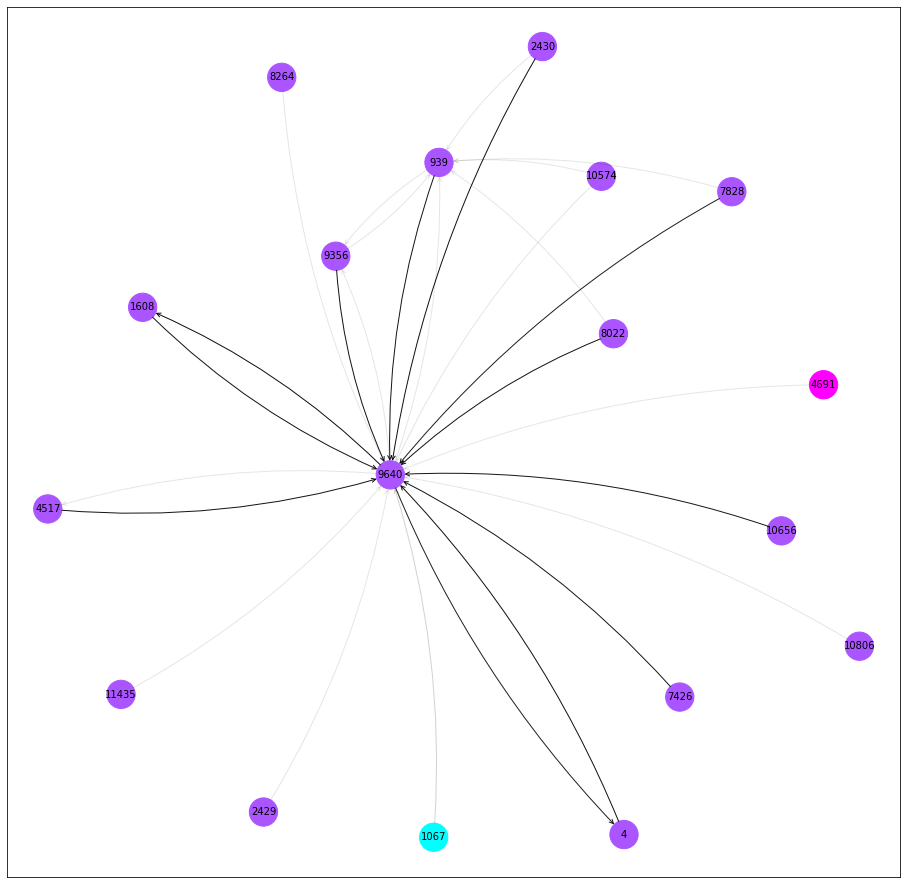

In [190]:
plt.figure(figsize=(16,16))

ax, G = explainer.visualize_subgraph(node_idx, data.edge_index, edge_mask, y=data.y)
plt.show()